# Cats vs Dogs

# I. Analyse exploratoire 

## 1. Libraries and data

In [77]:
%load_ext autoreload
%autoreload 2
import torch
import torch.nn as nn
from torchvision import transforms
import os
import matplotlib.pyplot as plt 
import matplotlib.image as img

from utils.dataset import CatDogDataset, custom_classifier, custom_segmentation
from utils.analyse import *
from models.model import CatDogClassifier, BreedClassifier, CatDogSegmentation, MultiTaskModel
from utils.train_val import *

from torch.optim import Adam
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.utils.data import DataLoader, random_split
from torch.utils.data import Subset

import torch.nn.functional as F
from torchsummary import summary
import torchinfo
from torchvision import models
import segmentation_models_pytorch as smp
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score,confusion_matrix


import random
import pandas as pd
import albumentations as A
from albumentations.pytorch import ToTensorV2
folder_path = os.path.dirname(os.getcwd())

import seaborn as sns

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")
code_path= os.getcwd()
folder_path = os.path.dirname(os.getcwd())
data_path = os.path.join(folder_path, 'Data','oxford-iiit-pet' )
image_path = os.path.join(data_path, 'images')
mask_path = os.path.join(data_path, 'annotations', 'trimaps')
frame_path = os.path.join(data_path, 'annotations', 'xmls')
logs_path = os.path.join(folder_path, 'Code', 'logs')


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Using device: cuda


## 2. Analyse exploratoire 

In [43]:
jpg_files = [f[:-4] for f in os.listdir(image_path) if f.lower().endswith(".jpg")]
xml_files = {f[:-4] for f in os.listdir(frame_path) if f.lower().endswith(".xml")}
mask_files = {f[:-4] for f in os.listdir(mask_path) if f.lower().endswith(".png")}
count_xml = 0
count_mask = 0
for jpg in jpg_files:
    if jpg in xml_files:
        count_xml += 1
    if jpg in mask_files:
        count_mask += 1
print("Total images:", len(jpg_files))
print("Images with matching XML:", count_xml)
print("Images with matching Mask:", count_mask)


Total images: 7390
Images with matching XML: 3686
Images with matching Mask: 7390


That means all images have mask correspondent but about half of them have matching bounding box (we don't use bounding box in this project)

In [2]:
# Import dataset into CatDogClassifier class
catdog_dataset = CatDogDataset(image_path= image_path,mask_path= mask_path, frame_path= frame_path)
len(catdog_dataset)
num_breed = catdog_dataset.num_breed
breed_num = catdog_dataset.breed_num
breeds_mapping = catdog_dataset.breeds_mapping
n_breed = len(pd.unique(catdog_dataset.df_label["breed"]))

Visualize some samples from the dataset

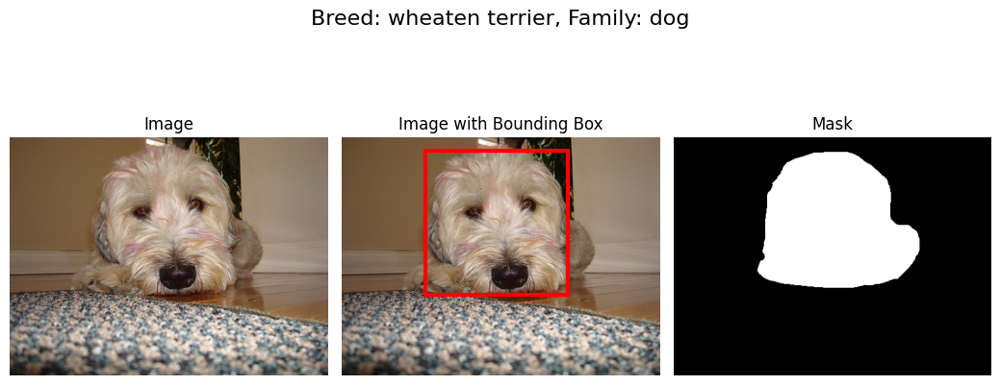

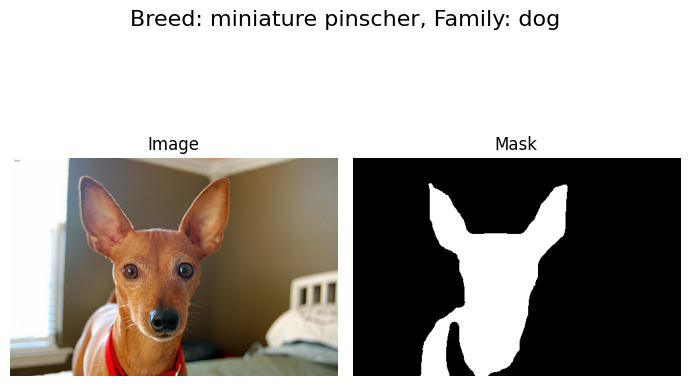

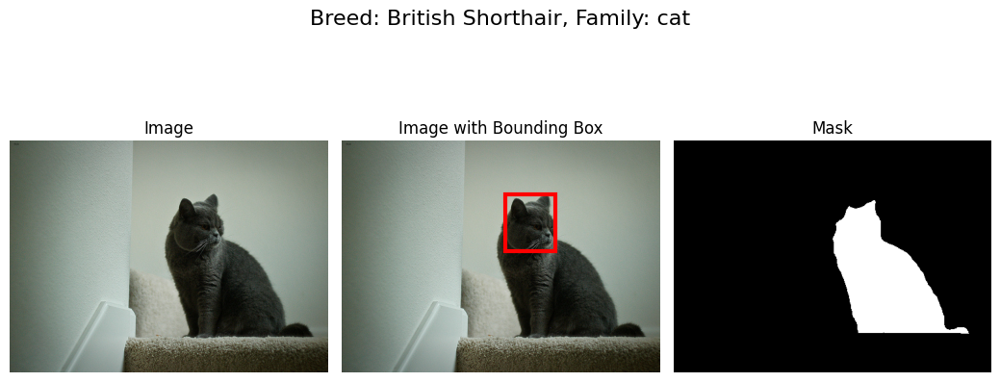

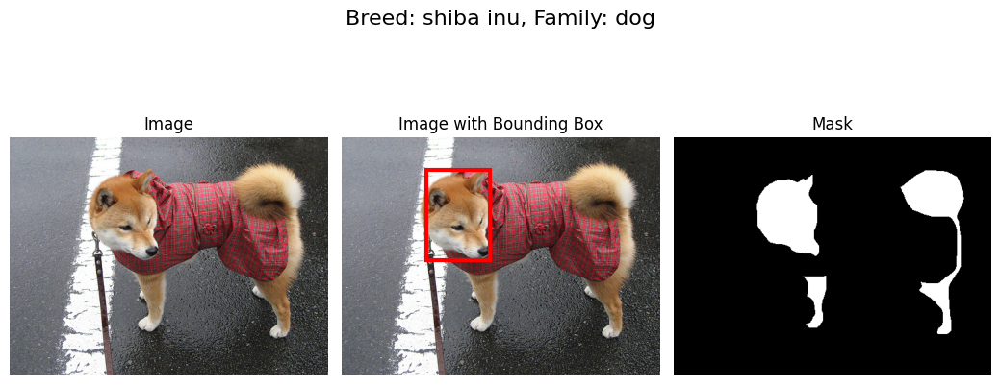

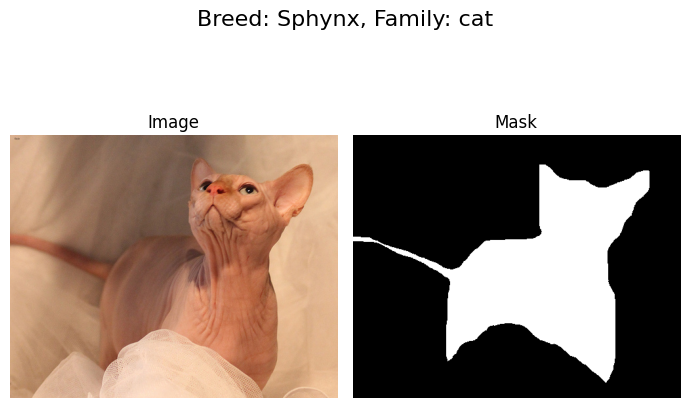

In [ ]:
for i in range(5):
    show_image(*catdog_dataset[random.randint(0, len(catdog_dataset)-1)])


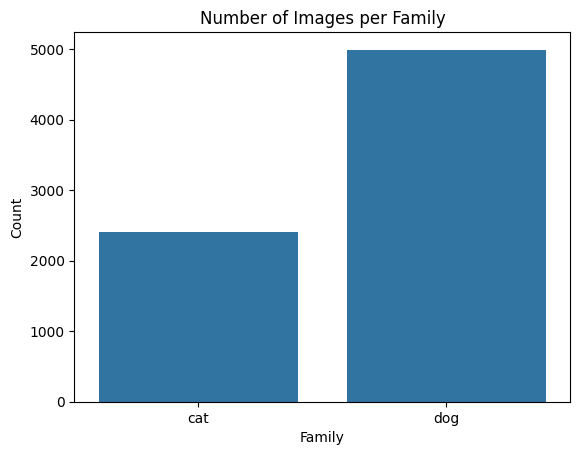

In [46]:
import seaborn as sns
sns.countplot(data=catdog_dataset.df_label, x='family')
plt.title("Number of Images per Family")
plt.xlabel("Family")
plt.ylabel("Count")
plt.show()


The number of dog images is twice the number of cat images. We could use a simple augmentation method to increase the number of cat images—perhaps upsampling.

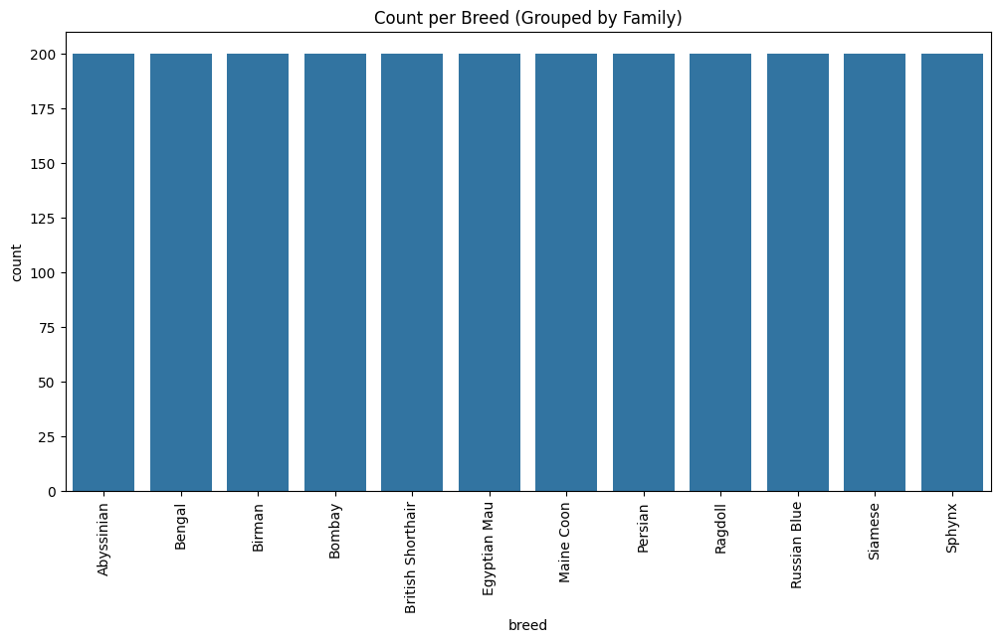

In [47]:
plt.figure(figsize=(12,6))
sns.countplot(data= catdog_dataset.df_label[catdog_dataset.df_label["family"]== "cat"], x='breed')
plt.title("Count per Breed (Grouped by Family)")
plt.xticks(rotation=90)
plt.show()


Number of cat's breed images seems very equivalent

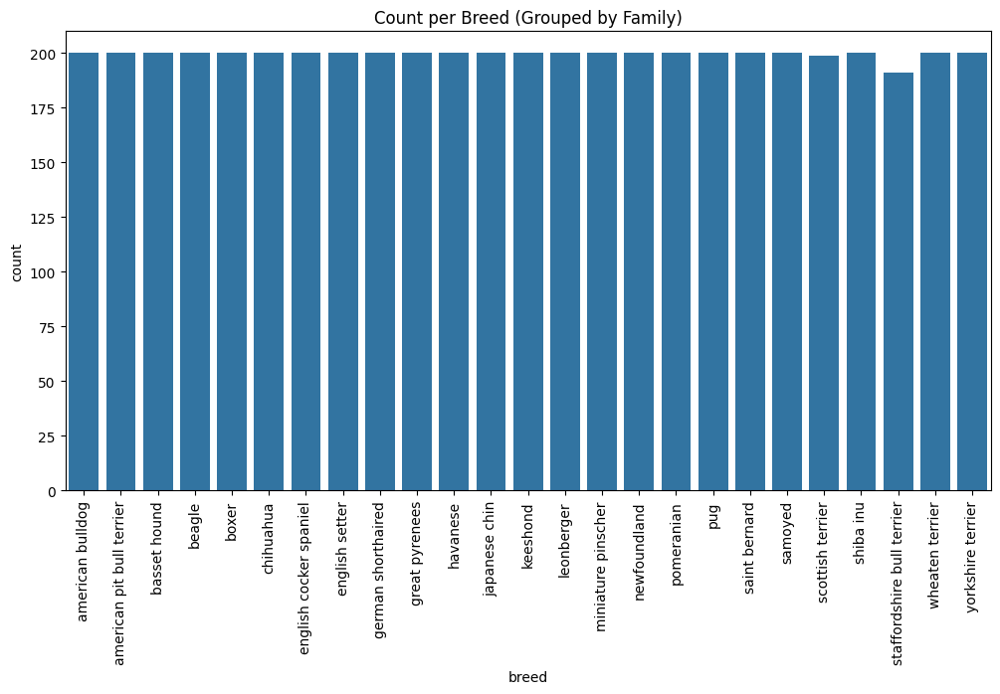

In [48]:
plt.figure(figsize=(12,6))
sns.countplot(data= catdog_dataset.df_label[catdog_dataset.df_label["family"]== "dog"], x='breed')
plt.title("Count per Breed (Grouped by Family)")
plt.xticks(rotation=90)
plt.show()

Number of dog's breed images seems very equivalent too

# II. Classification 

## 1. Preprocessing

In [ ]:
# balance by douplicate 
df = catdog_dataset.df_label
df_cats = df[df['family'] == 'cat']
df_dogs = df[df['family'] == 'dog']
df_cats_oversampled = pd.concat([df_cats] * 2, ignore_index=True)
df_balanced = pd.concat([df_cats_oversampled, df_dogs], ignore_index=True)

In [9]:
"""
# Attention, this cell may take some time to run
information = []

for i in range(len(catdog_dataset)):
    elements = catdog_dataset[i]
    
    info = [elements[0].size[0], elements[0].size[1]]
    if elements[2] is not None:
        info.append(1)
    else:
        info.append(0)
    information.append(info)
information_df =  pd.DataFrame(information, columns=['Height', 'Width', 'Has Bounding Box'])
information_df.to_csv(os.path.join(logs_path, 'image_heights_widths.csv'), index=False)
"""
information_df = pd.read_csv(os.path.join(logs_path, 'image_heights_widths.csv'))
information_df.describe()


,Height,Width,Has Bounding Box
count,7390.000000,7390.000000,7390.000000
mean,436.745196,390.913667,0.498782
std,115.877300,109.586324,0.500032
min,114.000000,103.000000,0.000000
25%,335.000000,333.000000,0.000000
50%,500.000000,375.000000,0.000000
75%,500.000000,500.000000,1.000000
max,3264.000000,2606.000000,1.000000


In [33]:
image_size = 224
train_transform = A.Compose(
    [
        A.HorizontalFlip(p=0.5),
        A.ShiftScaleRotate(shift_limit=0.1, scale_limit=0.2, rotate_limit=10, p=0.5),
        A.RandomBrightnessContrast(p=0.5),
        A.Resize(image_size, image_size),
        A.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]),
        ToTensorV2()
    ],
    bbox_params=A.BboxParams(format='pascal_voc', label_fields=['class_labels']),
)
test_transform = A.Compose(
    [
        A.Resize(image_size, image_size),
        A.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]),
        ToTensorV2()
    ],
    bbox_params=A.BboxParams(format='pascal_voc', label_fields=['class_labels']),
)



c:\Users\anhqu\anaconda3\envs\torch-env\Lib\site-packages\albumentations\core\validation.py:114: UserWarning: ShiftScaleRotate is a special case of Affine transform. Please use Affine transform instead.
  original_init(self, **validated_kwargs)


In [11]:
train_catdog = CatDogDataset(image_path, frame_path, mask_path) 
train_catdog.set_transform(train_transform)
train_catdog.df_label = df_balanced
test_catdog = CatDogDataset(image_path, frame_path, mask_path)
test_catdog.set_transform(test_transform)
test_catdog.df_label = df_balanced

indices = list(range(len(train_catdog)))
random.shuffle(indices)  


train_size = int(0.8 * len(indices))
train_indices = indices[:train_size]
test_indices = indices[train_size:]

train_catdog = Subset(train_catdog, train_indices)
test_catdog = Subset(test_catdog, test_indices)
"""
# Verify the transformation
for i in range(5):
    elements = test_dataset[i]
    show_image(image= elements[0].permute(1, 2, 0).numpy(),
               label= elements[1],
               anno= elements[2],
               mask= elements[3])"""

'\n# Verify the transformation\nfor i in range(5):\n    elements = test_dataset[i]\n    show_image(image= elements[0].permute(1, 2, 0).numpy(),\n               label= elements[1],\n               anno= elements[2],\n               mask= elements[3])'

## 2. Binary classification

### 2.1 Our model

In [9]:
# prepare train and test loader
batch_size = 64
train_catdog_loader = DataLoader(train_catdog, batch_size=batch_size, shuffle=True, collate_fn= custom_classifier)
test_catdog_loader = DataLoader(test_catdog, batch_size=batch_size, shuffle=False, collate_fn= custom_classifier)
print(f"Train dataset size: {len(train_catdog)}")
print(f"Test dataset size: {len(test_catdog)}")


Train dataset size: 7832
Test dataset size: 1958


In [9]:
model = CatDogClassifier().to(device)
summary(model, input_size=(3, image_size, image_size))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 224, 224]             896
       BatchNorm2d-2         [-1, 32, 224, 224]              64
              ReLU-3         [-1, 32, 224, 224]               0
         MaxPool2d-4         [-1, 32, 112, 112]               0
            Conv2d-5         [-1, 64, 112, 112]          18,496
       BatchNorm2d-6         [-1, 64, 112, 112]             128
              ReLU-7         [-1, 64, 112, 112]               0
         MaxPool2d-8           [-1, 64, 56, 56]               0
            Conv2d-9          [-1, 128, 56, 56]          73,856
      BatchNorm2d-10          [-1, 128, 56, 56]             256
             ReLU-11          [-1, 128, 56, 56]               0
        MaxPool2d-12          [-1, 128, 28, 28]               0
AdaptiveAvgPool2d-13            [-1, 128, 1, 1]               0
           Linear-14                   

In [ ]:
# Train model
epochs = 10
lr = 1e-4
criterion = torch.nn.CrossEntropyLoss()
optimizer = Adam(model.parameters(), lr=lr, weight_decay=1e-6)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2)
train_catdog_classifier(model= model,train_loader= train_catdog_loader, criterion = criterion ,optimizer = optimizer,scheduler = scheduler, epochs = 10, lr= 1e-4 )



In [ ]:
# Save model
torch.save(model.state_dict(), f"trained models/catdog_classifier_lr_{lr}_{image_size}x{image_size}.pth")

In [ ]:
# load model
#model.load_state_dict(torch.load("trained models/catdog_classifier_lr_0.0002_epochs_10.pth"))
# Calculate accuracy
model.eval()
pred = []
true = []
with torch.no_grad():
    for images, (_, family) in test_catdog_loader:
        images = images.to(device)
        family = family.to(device)

        outputs = model(images)
        predict = torch.argmax(F.softmax(outputs), 1)
        pred.append(predict)
        true.append(family)
all_preds = torch.cat(pred).cpu().numpy()
all_trues = torch.cat(true).cpu().numpy()

C:\Users\anhqu\AppData\Local\Temp\ipykernel_19920\2959529654.py:13: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  predict = torch.argmax(F.softmax(outputs), 1)


In [ ]:
precision_cat = precision_score(all_trues, all_preds, labels= [0], average='binary', pos_label=0)
recall_cat = recall_score(all_trues, all_preds, labels=[0], average='binary', pos_label=0)
precision_dog = precision_score(all_trues, all_preds, labels= [1], average='binary', pos_label=1)
recall_dog = recall_score(all_trues, all_preds, labels=[1], average='binary', pos_label=1)
accuracy = accuracy_score(all_trues, all_preds)
f1_score_ = f1_score(all_trues, all_preds)
print(f'Accuracy: {accuracy:.2f}')
print(f'Cat Precision: {precision_cat:.2f}, Recall: {recall_cat:.2f}')
print(f'Dog Precision: {precision_dog:.2f}, Recall: {recall_dog:.2f}')
print(f"F1 score: {f1_score_}") 


Accuracy: 0.68
Cat Precision: 0.68, Recall: 0.63
Dog Precision: 0.68, Recall: 0.72
F1 score: 0.7029843675982946


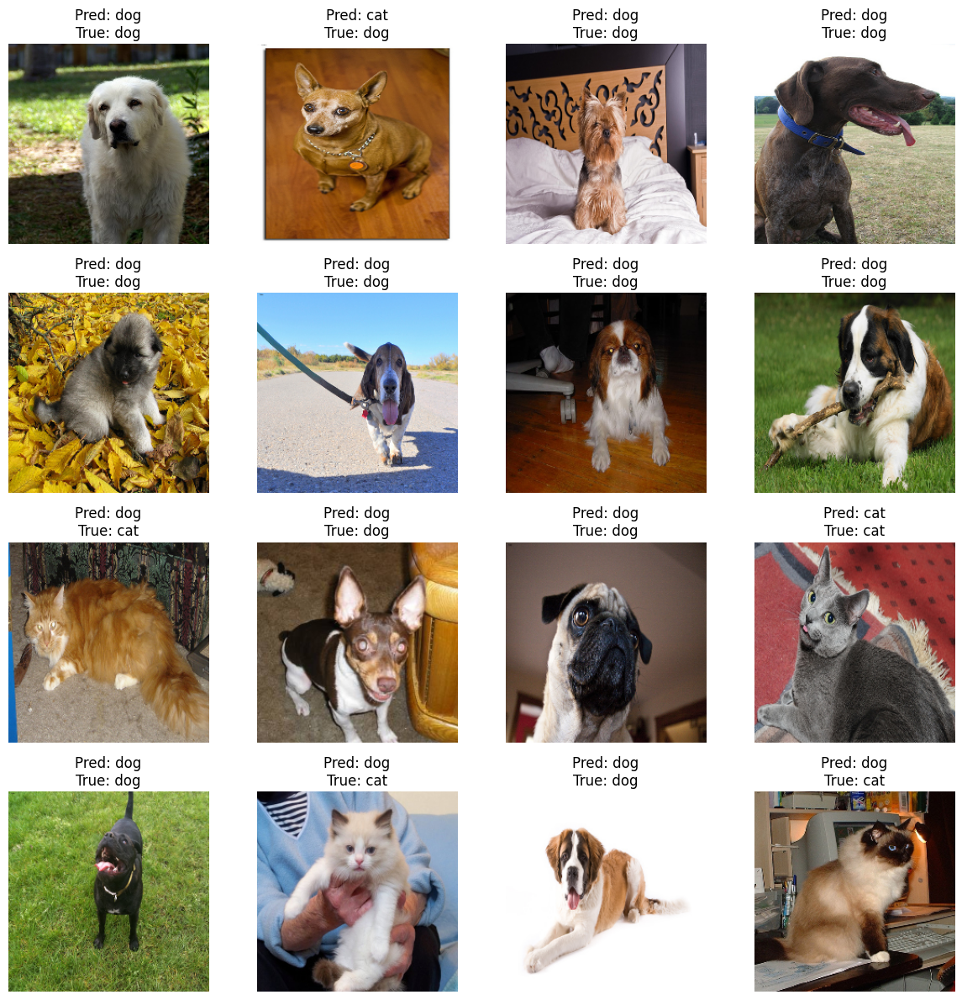

In [ ]:
# Test
display_classification(model, test_catdog_loader, type= "catdog", device= device)

### 2.2 Fine-tuning a pretrained model

In [218]:
model_catdog_ft = models.resnet18(pretrained = True).to(device)
summary(model=model_catdog_ft, input_size= (3,224,224))
n_features = model_catdog_ft.fc.in_features
model_catdog_ft.fc = nn.Linear(n_features,2).to(device)

c:\Users\anhqu\anaconda3\envs\torch-env\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning:

The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.

c:\Users\anhqu\anaconda3\envs\torch-env\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning:

Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.



----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 112, 112]           9,408
       BatchNorm2d-2         [-1, 64, 112, 112]             128
              ReLU-3         [-1, 64, 112, 112]               0
         MaxPool2d-4           [-1, 64, 56, 56]               0
            Conv2d-5           [-1, 64, 56, 56]          36,864
       BatchNorm2d-6           [-1, 64, 56, 56]             128
              ReLU-7           [-1, 64, 56, 56]               0
            Conv2d-8           [-1, 64, 56, 56]          36,864
       BatchNorm2d-9           [-1, 64, 56, 56]             128
             ReLU-10           [-1, 64, 56, 56]               0
       BasicBlock-11           [-1, 64, 56, 56]               0
           Conv2d-12           [-1, 64, 56, 56]          36,864
      BatchNorm2d-13           [-1, 64, 56, 56]             128
             ReLU-14           [-1, 64,

We examine this model without training on our dataset 

In [225]:
catdog_evaluation(model_catdog_ft, test_catdog_loader)

100%|██████████| 31/31 [00:07<00:00,  4.10it/s]


Accuracy: 0.51
Cat Precision: 0.47, Recall: 0.07
Dog Precision: 0.51, Recall: 0.93
F1 score: 0.6614785992217899


It is essentially a random classifier. The reason is that the model can extract features from animal images, but it doesn’t know how to use these features yet. Therefore, we train the model on our training dataset. To preserve the well-pretrained convolutional layers, we freeze them and train only the final linear layer.

In [ ]:
# Training
for name,params in model_catdog_ft.named_parameters():
    if "fc" not in name:
        params.requires_grad = False
epochs = 10
lr = 1e-4
criterion = torch.nn.CrossEntropyLoss()
optimizer = Adam(model_catdog_ft.parameters(), lr=lr, weight_decay=1e-6)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2)
train_catdog_classifier(model= model_catdog_ft,train_loader= train_catdog_loader, criterion = criterion ,optimizer = optimizer,scheduler = scheduler, epochs = 10, lr= 1e-4 )

Epoch 10/10 Loss: 0.1126 Learning rate: 0.000100: 100%|██████████| 93/93 [00:32<00:00,  2.88it/s]


In [226]:
#torch.save(model_catdog_ft.state_dict(), f"trained models/model_catdog_ft_lr_{lr}_epochs_{epochs}.pth")
model_catdog_ft.load_state_dict(torch.load("trained models/model_catdog_ft_lr_0.0005_epochs_4.pth"))

<All keys matched successfully>

In [227]:
catdog_evaluation(model_catdog_ft, test_catdog_loader)

100%|██████████| 31/31 [00:07<00:00,  4.11it/s]


Accuracy: 0.97
Cat Precision: 1.00, Recall: 0.94
Dog Precision: 0.95, Recall: 1.00
F1 score: 0.9724504591590141


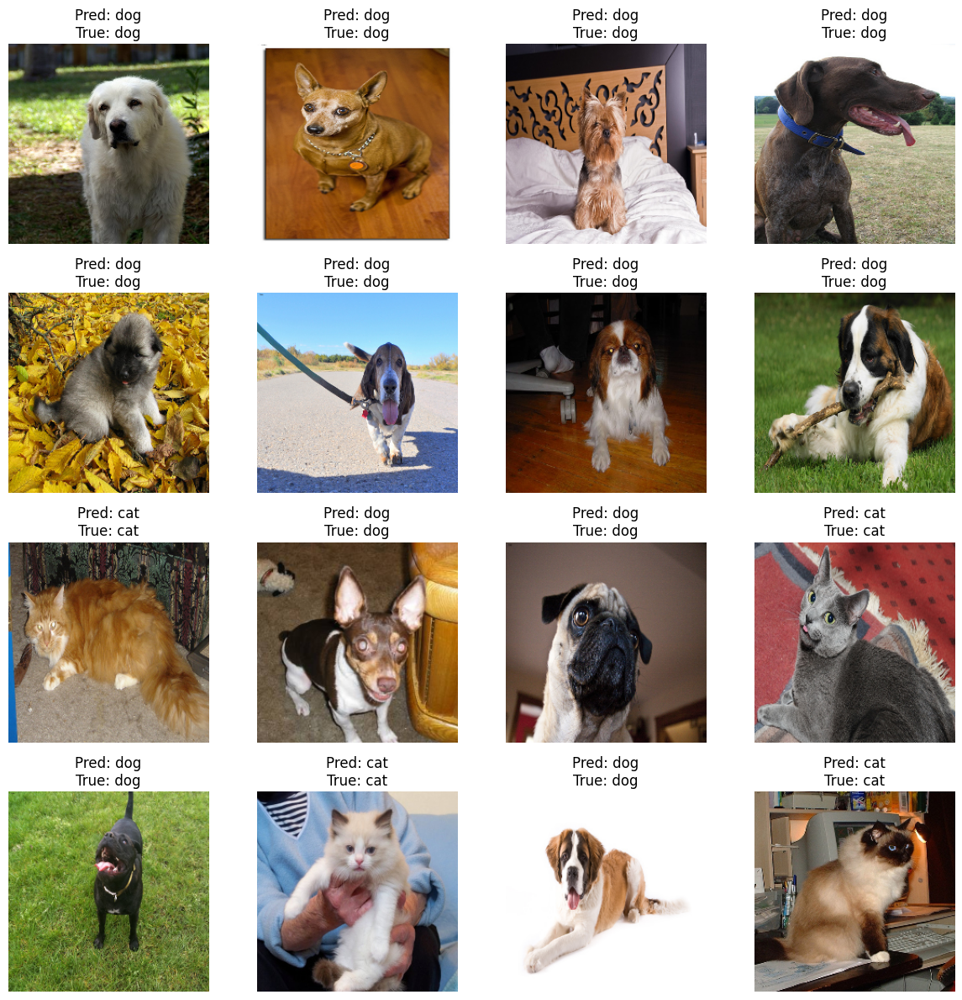

In [ ]:
display_classification(model_catdog_ft, test_catdog_loader, type= "catdog", device= device)

## 3. Breed classification 

### 3.1 Our model

In [ ]:
model_breed = BreedClassifier(n_breed).to(device)
summary(model_breed, input_size=(3, 224, 224))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 224, 224]             896
       BatchNorm2d-2         [-1, 32, 224, 224]              64
              ReLU-3         [-1, 32, 224, 224]               0
            Conv2d-4         [-1, 32, 224, 224]           9,248
              ReLU-5         [-1, 32, 224, 224]               0
            Conv2d-6         [-1, 32, 224, 224]           9,248
       BatchNorm2d-7         [-1, 32, 224, 224]              64
     ResidualBlock-8         [-1, 32, 224, 224]               0
         MaxPool2d-9         [-1, 32, 112, 112]               0
           Conv2d-10        [-1, 128, 112, 112]          36,992
      BatchNorm2d-11        [-1, 128, 112, 112]             256
             ReLU-12        [-1, 128, 112, 112]               0
           Conv2d-13        [-1, 128, 112, 112]         147,584
             ReLU-14        [-1, 128, 1

In [34]:
train_dataset = CatDogDataset(image_path, frame_path, mask_path) 
train_dataset.set_transform(train_transform)
test_dataset = CatDogDataset(image_path, frame_path, mask_path)
test_dataset.set_transform(test_transform)

indices = list(range(len(train_dataset)))
random.shuffle(indices)  


train_size = int(0.8 * len(indices))
train_indices = indices[:train_size]
test_indices = indices[train_size:]

train_dataset = Subset(train_dataset, train_indices)
test_dataset = Subset(test_dataset, test_indices)

batch_size = 64
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, collate_fn= custom_classifier)
test_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, collate_fn= custom_classifier)

In [ ]:
epochs = 4
lr = 5e-4
criterion = torch.nn.CrossEntropyLoss() 
optimizer = Adam(model_breed.parameters(), lr=lr, weight_decay=1e-6)
scheduler = model_breed(optimizer, mode='min', factor=0.5, patience=2)
train_breed_classifier(model_breed,train_loader, criterion,optimizer,scheduler, catdog_dataset.get_breed_num, epochs = epochs, lr= lr, device = "cuda" )

Epoch 1/1 Loss: 3.2448 Learning rate: 0.000500: 100%|██████████| 93/93 [28:47<00:00, 18.58s/it]


In [ ]:
#torch.save(model_breed.state_dict(), f"trained models/model_breed_lr_{lr}_epochs_{epochs}.pth")
model_breed.load_state_dict(torch.load("model_breed_lr_0.0005_epochs_4.pth"))

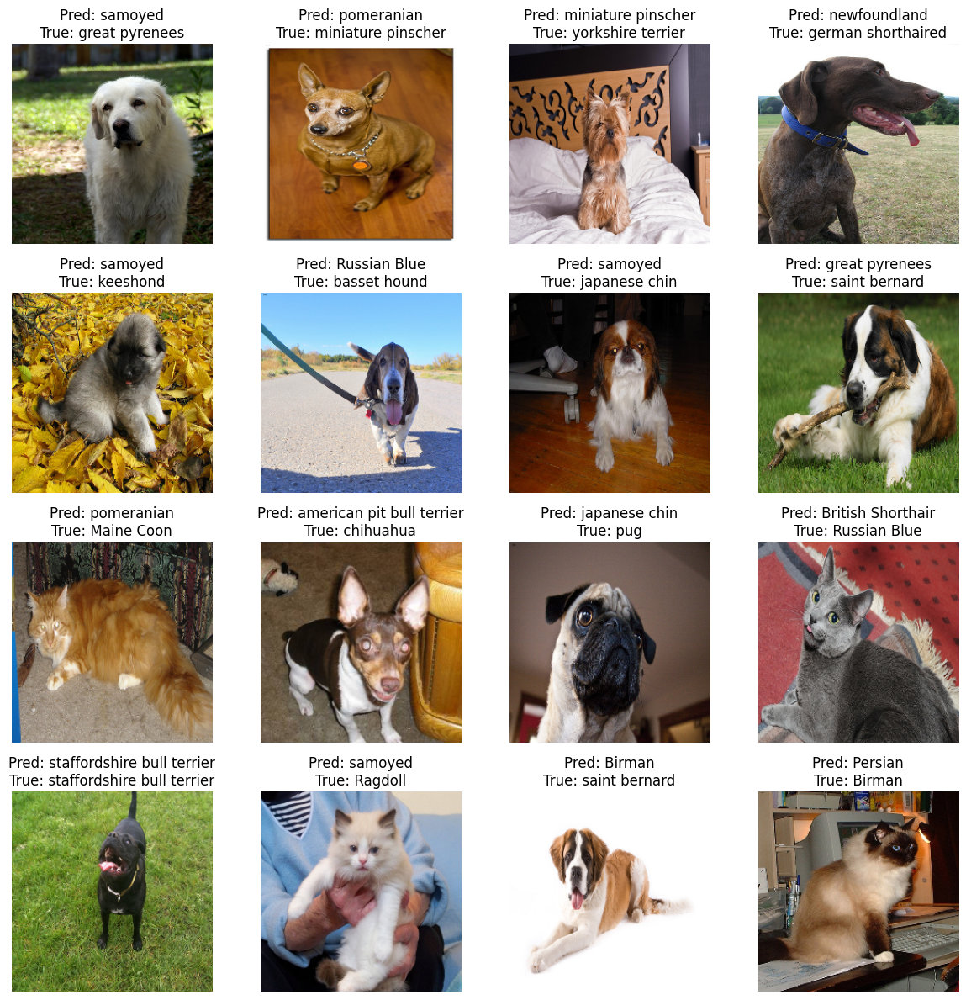

In [ ]:
# Test
#breed_model.load_state_dict(torch.load("trained models/breed_classifier_lr_0.0005_epochs_4.pth"))
display_classification(model_breed, test_loader, num_breed, type= "breed", device= device)

Accuracy: 0.11


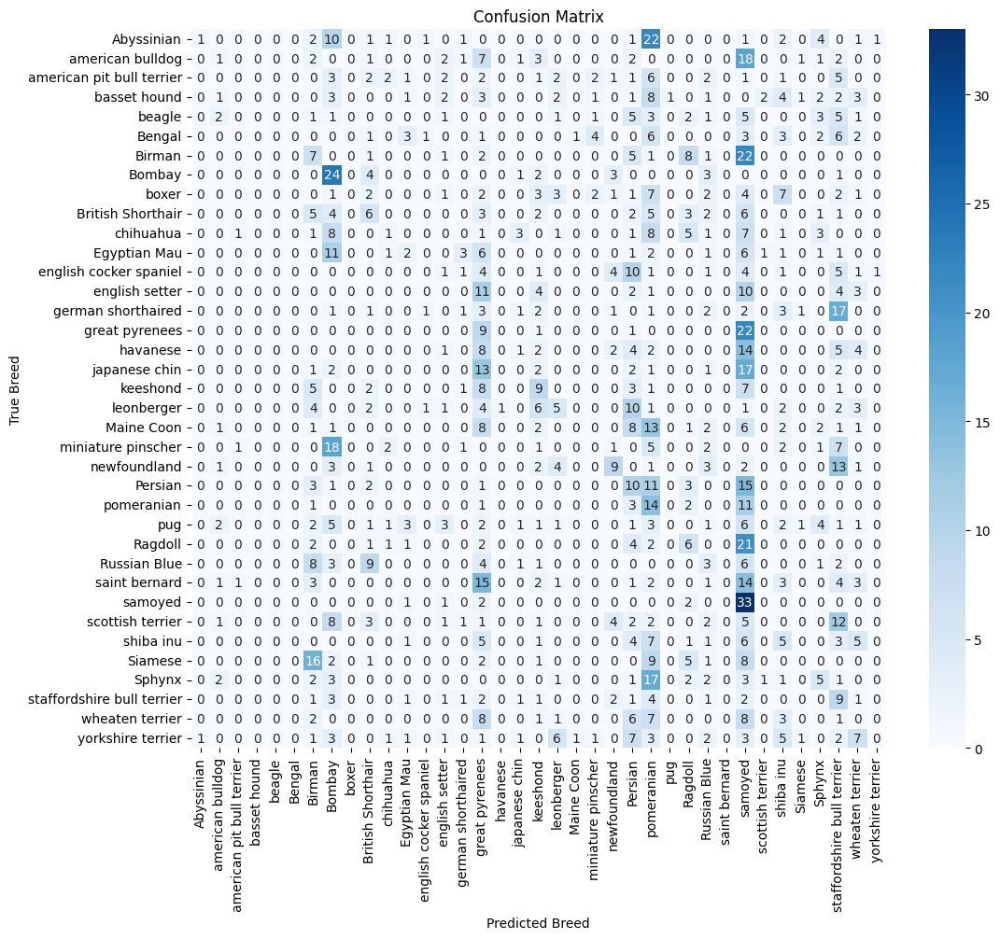

In [ ]:
breed_evaluation(model_breed, test_loader, breed_num.keys(), num_breed)

=== TOP 5 MOST CONFUSED BREED PAIRS ===
great pyrenees -> samoyed: 22 times
Birman -> samoyed: 22 times
Abyssinian -> pomeranian: 22 times
Ragdoll -> samoyed: 21 times
miniature pinscher -> Bombay: 18 times

=== EASILY DETECTED (Top 5) ===
       breed  f1_score  precision   recall  support
      Bombay  0.307692   0.203390 0.631579     38.0
newfoundland  0.264706   0.321429 0.225000     40.0
    keeshond  0.202247   0.173077 0.243243     37.0
     samoyed  0.195266   0.110368 0.846154     39.0
     Ragdoll  0.150000   0.150000 0.150000     40.0

=== HARDLY DETECTED (Bottom 5) ===
            breed  f1_score  precision  recall  support
              pug       0.0        0.0     0.0     42.0
          Siamese       0.0        0.0     0.0     45.0
 scottish terrier       0.0        0.0     0.0     43.0
  wheaten terrier       0.0        0.0     0.0     37.0
yorkshire terrier       0.0        0.0     0.0     48.0


### 3.2 Fine-tuning a pretrained model

I added some linear layers in the end of efficientnet_b3

In [231]:
model_breed_ft = models.efficientnet_b3(pretrained = True).to(device)
print(model_breed_ft)
n_features = model_breed_ft.classifier[1].in_features
model_breed_ft.classifier = nn.Sequential(
    nn.Dropout(0.3, inplace=True),
    nn.Linear(n_features, 512), nn.ReLU(inplace=True),
    nn.Linear(512,128), nn.ReLU(inplace=True),
    nn.Dropout(0.3),
    nn.Linear(128, n_breed)
).to(device)

c:\Users\anhqu\anaconda3\envs\torch-env\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning:

The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.

c:\Users\anhqu\anaconda3\envs\torch-env\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning:

Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=EfficientNet_B3_Weights.IMAGENET1K_V1`. You can also use `weights=EfficientNet_B3_Weights.DEFAULT` to get the most up-to-date weights.



EfficientNet(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 40, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): SiLU(inplace=True)
    )
    (1): Sequential(
      (0): MBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(40, 40, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=40, bias=False)
            (1): BatchNorm2d(40, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): SiLU(inplace=True)
          )
          (1): SqueezeExcitation(
            (avgpool): AdaptiveAvgPool2d(output_size=1)
            (fc1): Conv2d(40, 10, kernel_size=(1, 1), stride=(1, 1))
            (fc2): Conv2d(10, 40, kernel_size=(1, 1), stride=(1, 1))
            (activation): SiLU(inplace=True)
            (scale_activation): Sigmoid()
          )
          (2): Conv2dNormActiv

In [232]:
for param in model_breed_ft.parameters():
    param.requires_grad = False

for param in model_breed_ft.classifier.parameters():
    param.requires_grad = True
epochs = 4
lr = 5e-4
criterion = torch.nn.CrossEntropyLoss() 
optimizer = Adam(model_breed_ft.parameters(), lr=lr, weight_decay=1e-6)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2)
train_breed_classifier(model_breed_ft,train_loader, criterion,optimizer,scheduler, catdog_dataset.get_breed_num, epochs = epochs, lr= lr, device = "cuda" )

Epoch 4/4 Loss: 0.7760 Learning rate: 0.000500: 100%|██████████| 93/93 [03:17<00:00,  2.12s/it]


In [244]:
torch.save(model_breed_ft.state_dict(), f"trained models/model_breed_ft_lr_{lr}_epochs_{epochs}.pth")
#model_breed_ft.load_state_dict(torch.load("trained models/breed_classifier_lr_0.0005_epochs_4.pth"))

100%|██████████| 24/24 [00:51<00:00,  2.14s/it]


Accuracy: 0.83


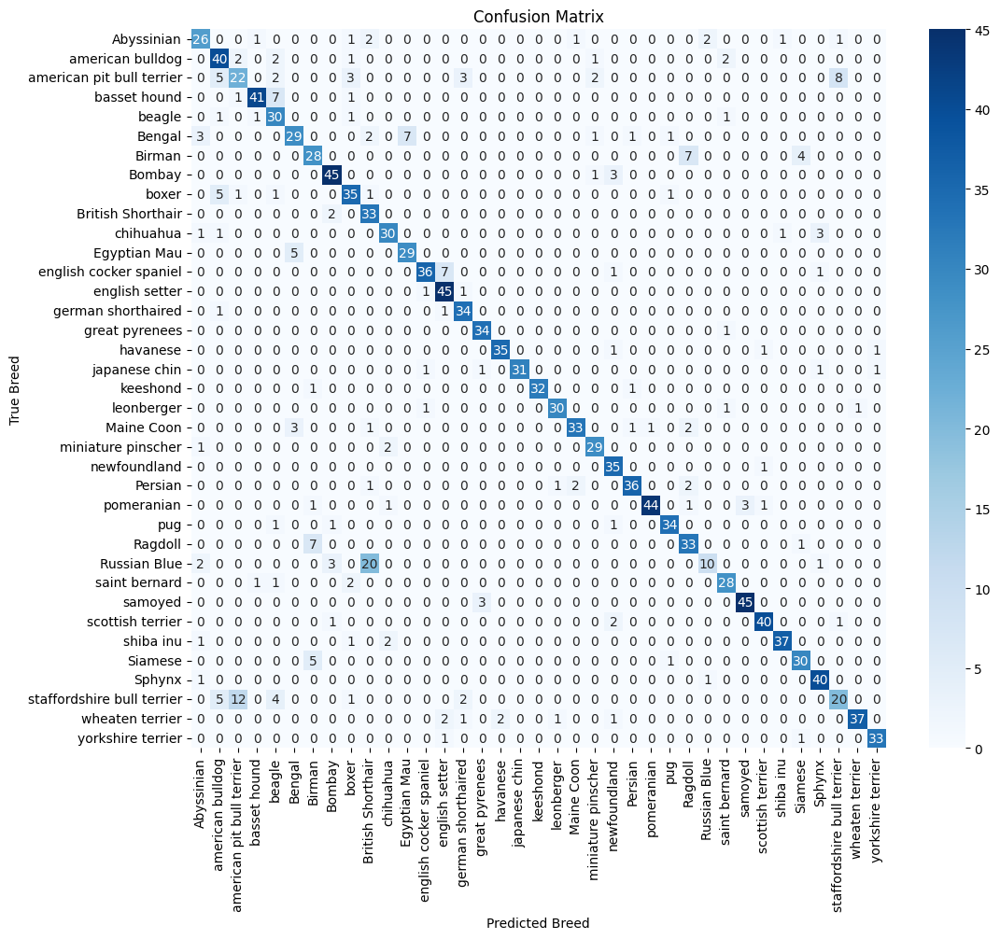

=== TOP 5 MOST CONFUSED BREED PAIRS ===
Russian Blue -> British Shorthair: 20 times
staffordshire bull terrier -> american pit bull terrier: 12 times
american pit bull terrier -> staffordshire bull terrier: 8 times
Ragdoll -> Birman: 7 times
english cocker spaniel -> english setter: 7 times

=== EASILY DETECTED (Top 5) ===
            breed  f1_score  precision   recall  support
         keeshond  0.969697   1.000000 0.941176     34.0
yorkshire terrier  0.942857   0.942857 0.942857     35.0
    japanese chin  0.939394   1.000000 0.885714     35.0
          samoyed  0.937500   0.937500 0.937500     48.0
         havanese  0.933333   0.945946 0.921053     38.0

=== HARDLY DETECTED (Bottom 5) ===
                     breed  f1_score  precision   recall  support
         British Shorthair  0.694737   0.550000 0.942857     35.0
                    Birman  0.691358   0.666667 0.717949     39.0
staffordshire bull terrier  0.540541   0.666667 0.454545     44.0
 american pit bull terrier  0.530

In [241]:
breed_evaluation(model_breed_ft, test_loader, breed_num= breed_num, num_breed= num_breed)

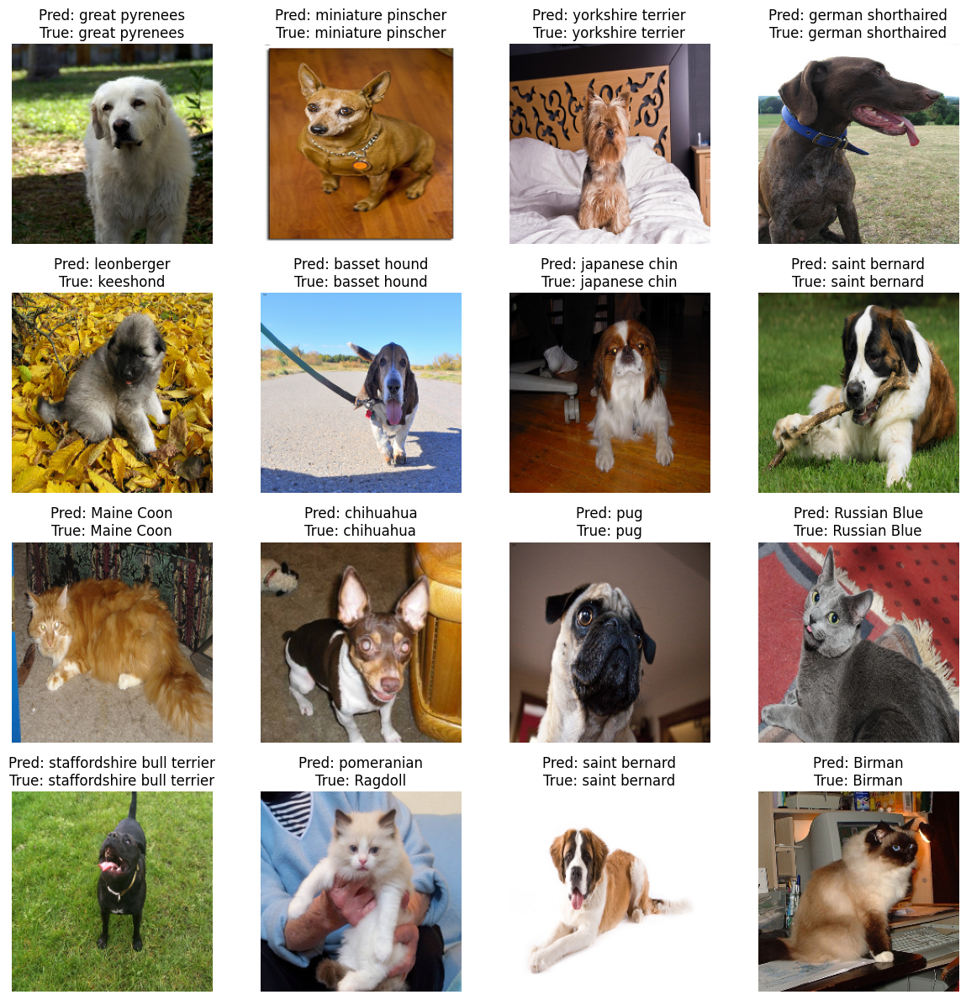

In [ ]:
display_classification(model_breed_ft, test_loader, num_breed, type= "breed", device= device)

## 4 Segmentation 

### 4.1 U-net from scratch

In [172]:
batch_size = 16
train_seg_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, collate_fn= custom_segmentation)
test_seg_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, collate_fn= custom_segmentation)

In [94]:
model_seg = CatDogSegmentation().to(device)
summary(model_seg, (3,224,224))


----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 224, 224]             896
              ReLU-2         [-1, 32, 224, 224]               0
            Conv2d-3         [-1, 32, 224, 224]           9,248
              ReLU-4         [-1, 32, 224, 224]               0
         MaxPool2d-5         [-1, 32, 112, 112]               0
            Conv2d-6         [-1, 64, 112, 112]          18,496
              ReLU-7         [-1, 64, 112, 112]               0
            Conv2d-8         [-1, 64, 112, 112]          36,928
              ReLU-9         [-1, 64, 112, 112]               0
        MaxPool2d-10           [-1, 64, 56, 56]               0
           Conv2d-11          [-1, 128, 56, 56]          73,856
             ReLU-12          [-1, 128, 56, 56]               0
           Conv2d-13          [-1, 128, 56, 56]         147,584
             ReLU-14          [-1, 128,

In [ ]:
epochs = 8
lr = 5e-4
criterion = nn.BCEWithLogitsLoss()
optimizer = Adam(model_seg.parameters(), lr=lr, weight_decay=1e-6)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2)
train_unet(model_seg, train_seg_loader, criterion, optimizer, scheduler, epochs=epochs, lr = lr)

Epoch 8/8 Loss: 0.2820 Learning rate: 0.001000: 100%|██████████| 370/370 [01:20<00:00,  4.61it/s]


In [99]:
torch.save(model_seg.state_dict(), f"trained models/model_segmentation_lr_{lr}_epochs_{epochs}.pth")

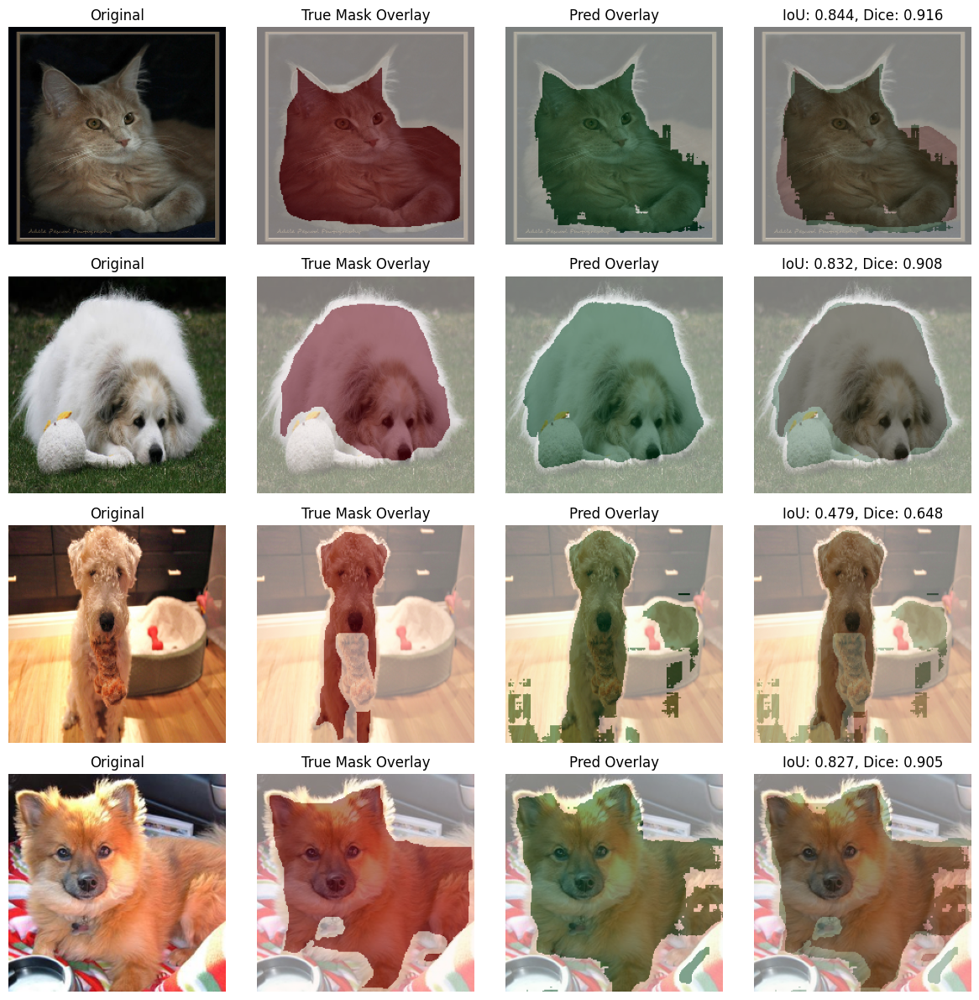

In [103]:
display_segmentation(model_seg, test_seg_loader)

In [173]:
segmentation_results = evaluate_segmentation(model_seg, test_seg_loader)

100%|██████████| 93/93 [00:10<00:00,  8.60it/s]


In [182]:
family_metrics_seg = segmentation_results.groupby('family').agg({
    'iou': ['mean', 'std', 'min', 'max'],
    'dice': ['mean', 'std', 'min', 'max']
}).reset_index()
breed_metrics_seg = segmentation_results.groupby('label').agg({
    'iou': ['mean', 'std', 'min', 'max'],
    'dice': ['mean', 'std', 'min', 'max']
}).reset_index()


In [188]:
show_table(segmentation_results, "")

In [187]:
show_table(family_metrics_seg, "Family Segmentation Metrics")
show_table(breed_metrics_seg, "Breed Segmentation Metrics")

### 4.2 UNet with Resnet34 backbone

In [4]:
model_seg_unet_ft = smp.Unet( encoder_name="resnet34", encoder_weights= "imagenet", in_channels=3, classes=1).to(device)
torchinfo.summary(model_seg_unet_ft, input_size=(1,3, 224, 224))

Layer (type:depth-idx)                        Output Shape              Param #
Unet                                          [1, 1, 224, 224]          --
├─ResNetEncoder: 1-1                          [1, 3, 224, 224]          --
│    └─Conv2d: 2-1                            [1, 64, 112, 112]         9,408
│    └─BatchNorm2d: 2-2                       [1, 64, 112, 112]         128
│    └─ReLU: 2-3                              [1, 64, 112, 112]         --
│    └─MaxPool2d: 2-4                         [1, 64, 56, 56]           --
│    └─Sequential: 2-5                        [1, 64, 56, 56]           --
│    │    └─BasicBlock: 3-1                   [1, 64, 56, 56]           73,984
│    │    └─BasicBlock: 3-2                   [1, 64, 56, 56]           73,984
│    │    └─BasicBlock: 3-3                   [1, 64, 56, 56]           73,984
│    └─Sequential: 2-6                        [1, 128, 28, 28]          --
│    │    └─BasicBlock: 3-4                   [1, 128, 28, 28]          230,144

We test pretrained model without training on our data to see its performance

In [ ]:
segmentation_results = evaluate_segmentation(model_seg_unet_ft, test_seg_loader)
family_metrics_seg = segmentation_results.groupby('family').agg({
    'iou': ['mean', 'std', 'min', 'max'],
    'dice': ['mean', 'std', 'min', 'max']
}).reset_index()
breed_metrics_seg = segmentation_results.groupby('label').agg({
    'iou': ['mean', 'std', 'min', 'max'],
    'dice': ['mean', 'std', 'min', 'max']
}).reset_index()
show_table(family_metrics_seg, "Family Segmentation Metrics")
show_table(breed_metrics_seg, "Breed Segmentation Metrics")

100%|██████████| 93/93 [00:11<00:00,  8.16it/s]


The results seems very bad, so we should train it on our data. Firstly, we train entirely this model.

In [ ]:
for param in model_seg_unet_ft.encoder.parameters():
    param.requires_grad = False
epochs = 8
lr = 5e-4
criterion = nn.BCEWithLogitsLoss()
optimizer = Adam(model_seg_unet_ft.parameters(), lr=lr, weight_decay=1e-6)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2)
train_unet(model_seg_unet_ft, train_seg_loader, criterion, optimizer, scheduler, epochs=epochs, lr = lr)

Epoch 8/8 Loss: 0.1293 Learning rate: 0.000500: 100%|██████████| 370/370 [01:23<00:00,  4.44it/s]


In [200]:
segmentation_results = evaluate_segmentation(model_seg_unet_ft, test_seg_loader)
family_metrics_seg = segmentation_results.groupby('family').agg({
    'iou': ['mean', 'std', 'min', 'max'],
    'dice': ['mean', 'std', 'min', 'max']
}).reset_index()
breed_metrics_seg = segmentation_results.groupby('label').agg({
    'iou': ['mean', 'std', 'min', 'max'],
    'dice': ['mean', 'std', 'min', 'max']
}).reset_index()
show_table(family_metrics_seg, "Family Segmentation Metrics")
show_table(breed_metrics_seg, "Breed Segmentation Metrics")


100%|██████████| 93/93 [00:10<00:00,  9.20it/s]


We freeze encoder block and train decoder block then freeze decoder block and train encoder block. 

In [207]:
model_seg_unet_ft = smp.Unet( encoder_name="resnet34", encoder_weights= "imagenet", in_channels=3, classes=1).to(device)
for param in model_seg_unet_ft.encoder.parameters():
    param.requires_grad = False
epochs = 8
lr = 5e-4
criterion = nn.BCEWithLogitsLoss()
optimizer = Adam(model_seg_unet_ft.parameters(), lr=lr, weight_decay=1e-6)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2)
train_unet(model_seg_unet_ft, train_seg_loader, criterion, optimizer, scheduler, epochs=epochs, lr = lr)
for param in model_seg_unet_ft.decoder.parameters():
    param.requires_grad = False
lr = 2e-4
train_unet(model_seg_unet_ft, train_seg_loader, criterion, optimizer, scheduler, epochs=epochs, lr = lr)

Epoch 8/8 Loss: 0.0866 Learning rate: 0.000125: 100%|██████████| 370/370 [00:48<00:00,  7.64it/s]


In [209]:
segmentation_results = evaluate_segmentation(model_seg_unet_ft, test_seg_loader)
family_metrics_seg = segmentation_results.groupby('family').agg({
    'iou': ['mean', 'std', 'min', 'max'],
    'dice': ['mean', 'std', 'min', 'max']
}).reset_index()
breed_metrics_seg = segmentation_results.groupby('label').agg({
    'iou': ['mean', 'std', 'min', 'max'],
    'dice': ['mean', 'std', 'min', 'max']
}).reset_index()
show_table(family_metrics_seg, "Family Segmentation Metrics")
show_table(breed_metrics_seg, "Breed Segmentation Metrics")

100%|██████████| 93/93 [00:11<00:00,  8.39it/s]


We obtain the best results so we save it to `trained models`

In [211]:
torch.save(model_seg_unet_ft.state_dict(), f"trained models/model_segmentation_ft_lr_{lr}_epochs_{epochs}.pth")

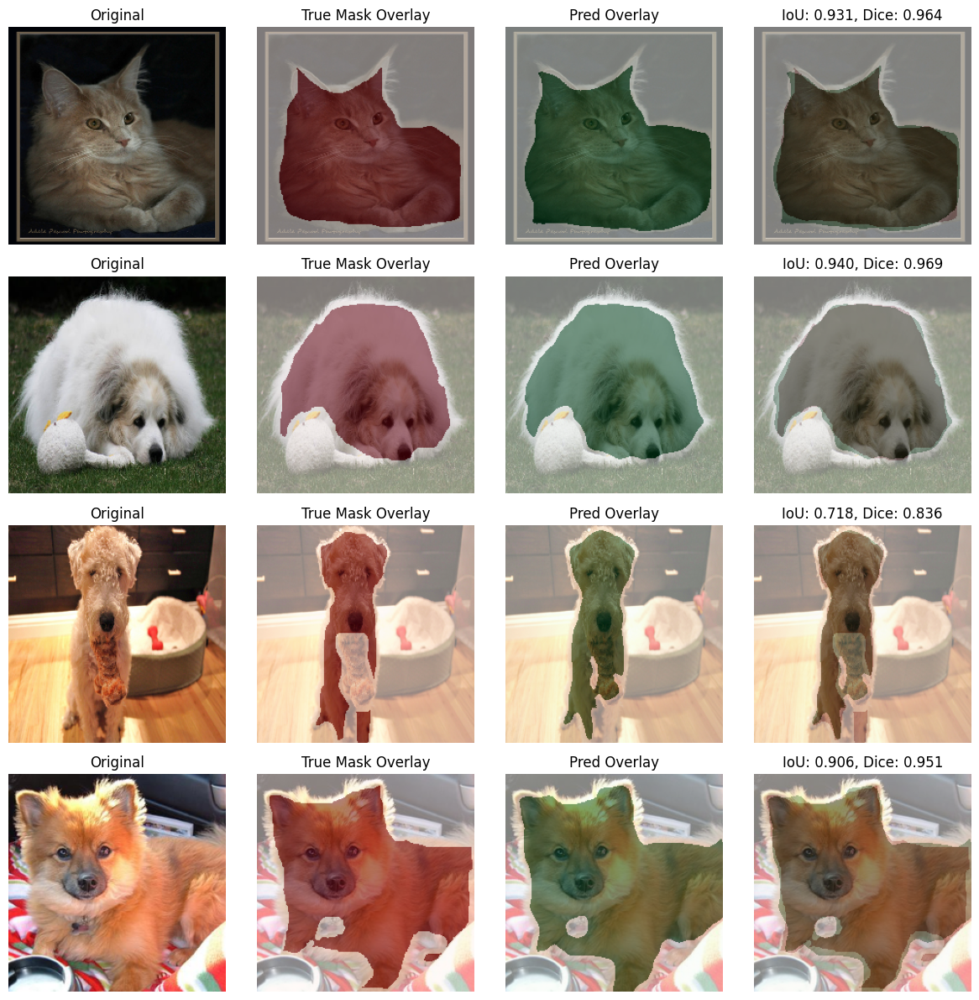

In [212]:
display_segmentation(model_seg_unet_ft, test_seg_loader)

### 4.3 Unet ++ with Resnet34 backbone

In [216]:
model_seg_unetpp_ft = smp.UnetPlusPlus( encoder_name="resnet34", encoder_weights="imagenet", in_channels=3, classes=1).to(device)
for param in model_seg_unetpp_ft.encoder.parameters():
    param.requires_grad = False
epochs = 4
lr = 5e-4
criterion = nn.BCEWithLogitsLoss()
optimizer = Adam(model_seg_unetpp_ft.parameters(), lr=lr, weight_decay=1e-6)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2)
train_unet(model_seg_unetpp_ft, train_seg_loader, criterion, optimizer, scheduler, epochs=epochs, lr = lr)
for param in model_seg_unetpp_ft.decoder.parameters():
    param.requires_grad = False
lr = 2e-4
train_unet(model_seg_unetpp_ft, train_seg_loader, criterion, optimizer, scheduler, epochs=epochs, lr = lr)

Epoch 4/4 Loss: 0.1057 Learning rate: 0.000500: 100%|██████████| 370/370 [15:50<00:00,  2.57s/it]


In [217]:
segmentation_results = evaluate_segmentation(model_seg_unetpp_ft, test_seg_loader)
family_metrics_seg = segmentation_results.groupby('family').agg({
    'iou': ['mean', 'std', 'min', 'max'],
    'dice': ['mean', 'std', 'min', 'max']
}).reset_index()
breed_metrics_seg = segmentation_results.groupby('label').agg({
    'iou': ['mean', 'std', 'min', 'max'],
    'dice': ['mean', 'std', 'min', 'max']
}).reset_index()
show_table(family_metrics_seg, "Family Segmentation Metrics")
show_table(breed_metrics_seg, "Breed Segmentation Metrics")

100%|██████████| 93/93 [04:03<00:00,  2.62s/it]


In [245]:
torch.save(model_seg_unetpp_ft.state_dict(), f"trained models/model_segmentation_unetpp_ft_lr_{lr}_epochs_{epochs}.pth")

## 5. Analyse comparative

In [242]:
show_table(family_metrics_seg, "Family Segmentation Metrics")
show_table(breed_metrics_seg, "Breed Segmentation Metrics")

From results about many segmentation models, we can observe that 
- The cat's segmentation seems better than the dog one


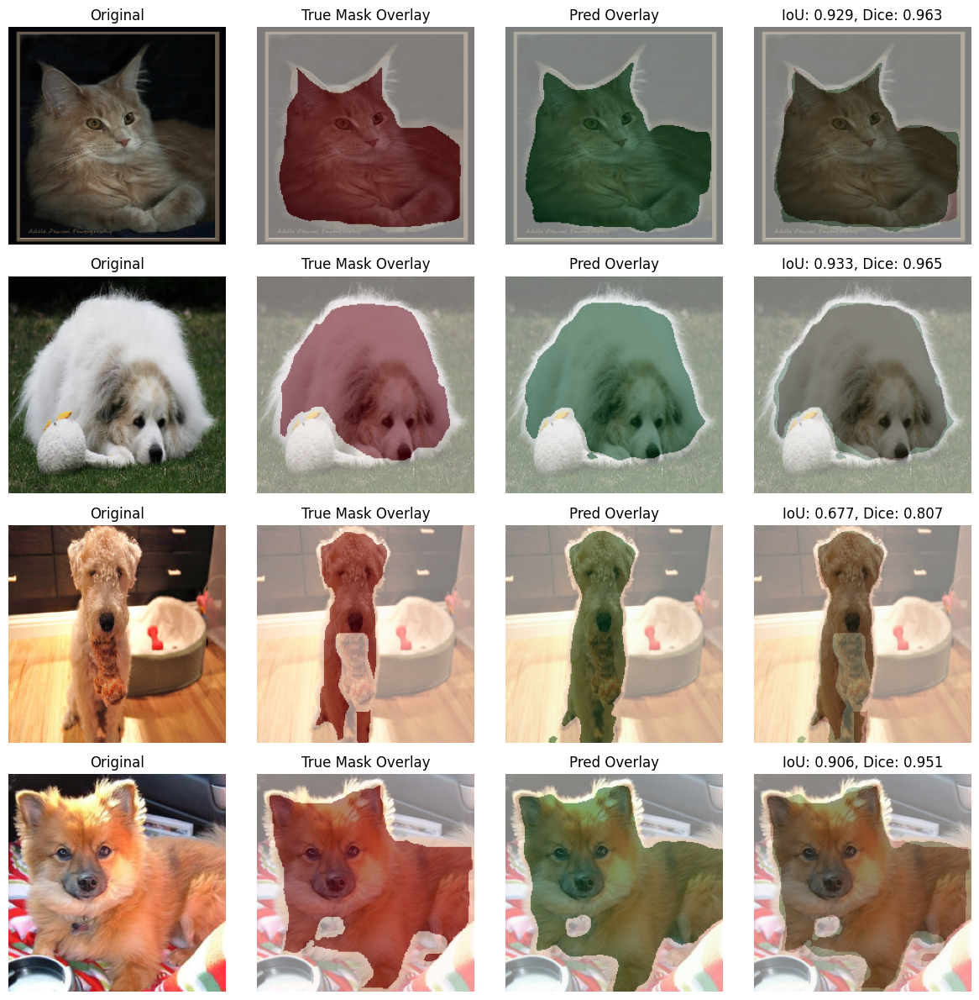

In [246]:
display_segmentation(model_seg_unetpp_ft, test_seg_loader)

## 6. Multi-task: classification and segmentation  

We use our model for this multi-task. Our model consists an encoder with CNN backbone to extract features (we recommend ResNet34), a segmentation decoder (U-Net style) and a classification head (Linear layers). Segmentation decoder and Classification head share input given by the encoder 

In [24]:
multi_task_model = MultiTaskModel(num_classes=2).to(device)
torchinfo.summary(multi_task_model, (1,3,224,224))

Layer (type:depth-idx)                        Output Shape              Param #
MultiTaskModel                                [1, 2]                    --
├─ResNetEncoder: 1-1                          [1, 3, 224, 224]          --
│    └─Conv2d: 2-1                            [1, 64, 112, 112]         9,408
│    └─BatchNorm2d: 2-2                       [1, 64, 112, 112]         128
│    └─ReLU: 2-3                              [1, 64, 112, 112]         --
│    └─MaxPool2d: 2-4                         [1, 64, 56, 56]           --
│    └─Sequential: 2-5                        [1, 64, 56, 56]           --
│    │    └─BasicBlock: 3-1                   [1, 64, 56, 56]           73,984
│    │    └─BasicBlock: 3-2                   [1, 64, 56, 56]           73,984
│    │    └─BasicBlock: 3-3                   [1, 64, 56, 56]           73,984
│    └─Sequential: 2-6                        [1, 128, 28, 28]          --
│    │    └─BasicBlock: 3-4                   [1, 128, 28, 28]          230,144

Then, we train this model by freezing encoder

In [45]:
train_multi_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, collate_fn= custom_segmentation)
test_multi_loader = DataLoader(test_dataset, batch_size=batch_size, shuffle=False, collate_fn= custom_segmentation)
for params in multi_task_model.encoder.parameters():
    params.requires_grad = False
epochs = 4
lr = 5e-4
criterion = ( nn.CrossEntropyLoss(),nn.BCEWithLogitsLoss())
optimizer = Adam(multi_task_model.parameters(), lr=lr, weight_decay=1e-6)
scheduler = ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=2)
catdog_num = {
    'cat' : 0,
    'dog' : 1
}
train_multimodel(multi_task_model, train_multi_loader, criterion, optimizer, scheduler, catdog_num,"catdog", epochs=epochs, lr=lr)


Epoch 1/4  Classification loss: 0.0885 Segmentation loss: 0.1354 Learning rate: 0.000500: 100%|██████████| 93/93 [06:56<00:00,  4.48s/it]
Epoch 2/4  Classification loss: 0.0091 Segmentation loss: 0.1209 Learning rate: 0.000500: 100%|██████████| 93/93 [06:41<00:00,  4.32s/it]
Epoch 3/4  Classification loss: 0.1379 Segmentation loss: 0.1139 Learning rate: 0.000500: 100%|██████████| 93/93 [06:38<00:00,  4.28s/it]
Epoch 4/4  Classification loss: 0.4740 Segmentation loss: 0.1455 Learning rate: 0.000500: 100%|██████████| 93/93 [06:37<00:00,  4.28s/it]


In [46]:
torch.save(multi_task_model.state_dict(), f"trained models/model_multitask_lr_{lr}_epochs_{epochs}.pth")

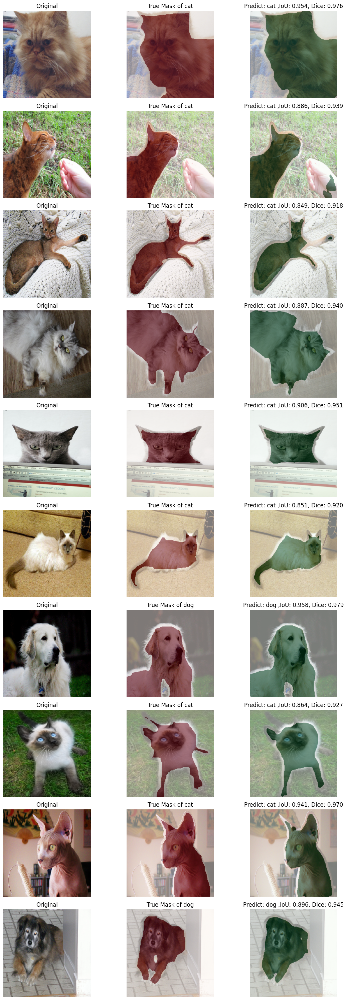

In [75]:
num_catdog = {
    0: "cat",
    1: "dog"
}
display_multitask(multi_task_model, test_multi_loader,num_catdog,n_images=10,type = "catdog")

In [ ]:
multi_results = multi_evaluation(multi_task_model, test_multi_loader, catdog_num)

100%|██████████| 24/24 [00:17<00:00,  1.36it/s]


,True label,Pred label,iou,dice
0,0,"tensor(0, device='cuda:0')",0.953613,0.976256
1,0,"tensor(0, device='cuda:0')",0.885883,0.939489
2,0,"tensor(0, device='cuda:0')",0.849219,0.918463
3,0,"tensor(0, device='cuda:0')",0.887332,0.940303
4,0,"tensor(0, device='cuda:0')",0.905709,0.950522
...,...,...,...,...
1473,1,"tensor(1, device='cuda:0')",0.845013,0.915997
1474,1,"tensor(1, device='cuda:0')",0.827625,0.905683
1475,1,"tensor(1, device='cuda:0')",0.937699,0.967848
1476,1,"tensor(1, device='cuda:0')",0.863761,0.926901
